This is a sample notebook of a credit card probability of payment model using xgboost.

In [1]:
import pandas as pd
import numpy as np
import os
from various_functions import dum_sign
import sidetable
import seaborn as sns
import matplotlib.pyplot as plt

pd.options.mode.use_inf_as_na = True
pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [2]:
os.chdir('C:\\Bossa Nova\\collections agency models\\OA\\Development CC April 2019')

In [3]:
df = pd.read_stata("cc_oa_carga_historica_pythn_prjct.dta")

clean up pago_general column to get 0 for no payment and 1 for payment

In [4]:
df['pago_general'] = df['pago_general'].replace(['master only (1)'],'1')

In [5]:
df['pago_general'] = pd.to_numeric(df['pago_general'], errors='coerce')

In [6]:
df.head()

,location,banco,agencia,dir_reg,dt_nasc,uf,iden_tel1,ddd_tel1,iden_tel2,ddd_tel2,iden_tel3,ddd_tel3,iden_tel4,ddd_tel4,iden_tel5,ddd_tel5,iden_tel6,ddd_tel6,rating,dt_desde,nat_oper,carteira,vcto_antig,vl_vcto_cor,resp_contr,resp_cliente,ident_seg,produto,subproduto,familia,convenio,bs1,cs1,ct1,num_contrato,dias_atraso,data_lig,term_code,cont_lig,saldo_totcli6,saldo_cart6,saldo_ccmrcl6,mesasig,dataasig,pj,cnpj15,cpf11,cpfcnpj15,valorpagamento,datapagamento,pago_general
0,010102,237,0313,4354,20/01/1994,SP,X,00,V,11,X,00,X,00,V,11,X,00,C,04/07/1995,001,351,22/02/2019,741,741,43433,000,004,003,3,000000000,000,000,000,00000000001866261,5,,,000,741.700012,0.000000,741.700012,201902,2019-02-27,1.0,000001813000104,00000181304,000001813000104,2369.94,22/01/2019,1
1,101010,,00309,,19/02/1963,RJ,V,21,X,00,X,00,V,21,X,00,X,00,,01/06/1994,3,,15/02/2019,271,0,0,,000,000,0,000000000,014,013,000,00000000000724215,15,,,000,271.809998,271.809998,0.000000,201901,2019-01-31,0.0,000002457000004,00000245704,00000000245704,NaN,,0
2,101010,,00685,,23/12/1982,CE,X,00,X,00,X,00,V,88,V,88,X,00,,13/11/2012,3,,05/12/2018,261,0,0,,000,000,0,000000000,022,000,000,00000000005526167,35,,,000,261.140015,261.140015,0.000000,201812,2018-12-11,0.0,000002683000021,00000268321,00000000268321,NaN,,0
3,101010,,00679,,15/02/1986,PA,X,00,X,00,X,00,V,91,X,00,X,00,,31/07/2018,3,,10/01/2019,362,0,0,,000,000,0,000000000,023,013,000,00000000005448001,15,,,000,362.890015,362.890015,0.000000,201901,2019-01-28,0.0,000003672000022,00000367222,00000000367222,368.74,01/02/2019,1
4,101010,,04025,,17/06/1963,RJ,X,00,X,00,X,00,V,21,X,00,X,00,,28/08/2003,3,,25/12/2018,58,0,0,,000,000,0,000000000,012,012,000,00000000007540803,9,,,000,58.599998,58.599998,0.000000,201901,2019-01-04,0.0,000004527000069,00000452769,00000000452769,NaN,,0


In [7]:
df.describe()

,vl_vcto_cor,resp_contr,resp_cliente,dias_atraso,saldo_totcli6,saldo_cart6,saldo_ccmrcl6,pj,valorpagamento,pago_general
count,3.063470e+05,306347.000000,306347.000000,306347.000000,3.063470e+05,3.063470e+05,3.063470e+05,306347.000000,115388.000000,306347.000000
mean,1.445289e+03,1242.849435,4278.905676,14.282180,4.030688e+03,1.557948e+03,2.472626e+03,0.168117,1086.804070,0.376658
std,8.541782e+03,13806.790601,31265.528131,11.003552,2.750265e+04,9.018295e+03,2.524375e+04,0.372949,3069.818025,0.484549
min,4.900000e+01,0.000000,0.000000,5.000000,4.935000e+01,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000
25%,2.290000e+02,0.000000,0.000000,7.000000,3.109400e+02,1.859900e+02,0.000000e+00,0.000000,187.710000,0.000000
50%,5.210000e+02,0.000000,0.000000,10.000000,7.282500e+02,5.028900e+02,0.000000e+00,0.000000,442.305000,0.000000
75%,1.093000e+03,0.000000,0.000000,16.000000,1.771610e+03,1.127645e+03,2.821950e+02,0.000000,1022.640000,1.000000
max,3.290767e+06,599958.000000,599958.000000,120.000000,3.290767e+06,3.290767e+06,2.944226e+06,1.000000,329000.000000,1.000000


In [8]:
df.columns

Index(['location', 'banco', 'agencia', 'dir_reg', 'dt_nasc', 'uf', 'iden_tel1',
       'ddd_tel1', 'iden_tel2', 'ddd_tel2', 'iden_tel3', 'ddd_tel3',
       'iden_tel4', 'ddd_tel4', 'iden_tel5', 'ddd_tel5', 'iden_tel6',
       'ddd_tel6', 'rating', 'dt_desde', 'nat_oper', 'carteira', 'vcto_antig',
       'vl_vcto_cor', 'resp_contr', 'resp_cliente', 'ident_seg', 'produto',
       'subproduto', 'familia', 'convenio', 'bs1', 'cs1', 'ct1',
       'num_contrato', 'dias_atraso', 'data_lig', 'term_code', 'cont_lig',
       'saldo_totcli6', 'saldo_cart6', 'saldo_ccmrcl6', 'mesasig', 'dataasig',
       'pj', 'cnpj15', 'cpf11', 'cpfcnpj15', 'valorpagamento', 'datapagamento',
       'pago_general'],
      dtype='object')

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 306347 entries, 0 to 306346
Data columns (total 51 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   location        306347 non-null  object        
 1   banco           306347 non-null  object        
 2   agencia         306347 non-null  object        
 3   dir_reg         306347 non-null  object        
 4   dt_nasc         306347 non-null  object        
 5   uf              306347 non-null  object        
 6   iden_tel1       306347 non-null  object        
 7   ddd_tel1        306347 non-null  object        
 8   iden_tel2       306347 non-null  object        
 9   ddd_tel2        306347 non-null  object        
 10  iden_tel3       306347 non-null  object        
 11  ddd_tel3        306347 non-null  object        
 12  iden_tel4       306347 non-null  object        
 13  ddd_tel4        306347 non-null  object        
 14  iden_tel5       306347 non-null  obj

In [10]:
df.stb.freq(['term_code'])

,term_code,count,percent,cumulative_count,cumulative_percent
0,,306347,100.0,306347,100.0


drop columns we don't need:

In [11]:
df = df.drop(['mesasig', 'ct1', 'data_lig', 'term_code', 'cont_lig',
              'cnpj15', 'cpfcnpj15'], axis = 1) 

array([[<AxesSubplot:title={'center':'vl_vcto_cor'}>,
        <AxesSubplot:title={'center':'resp_contr'}>,
        <AxesSubplot:title={'center':'resp_cliente'}>],
       [<AxesSubplot:title={'center':'dias_atraso'}>,
        <AxesSubplot:title={'center':'saldo_totcli6'}>,
        <AxesSubplot:title={'center':'saldo_cart6'}>],
       [<AxesSubplot:title={'center':'saldo_ccmrcl6'}>,
        <AxesSubplot:title={'center':'dataasig'}>,
        <AxesSubplot:title={'center':'pj'}>],
       [<AxesSubplot:title={'center':'valorpagamento'}>,
        <AxesSubplot:title={'center':'pago_general'}>, <AxesSubplot:>]],
      dtype=object)

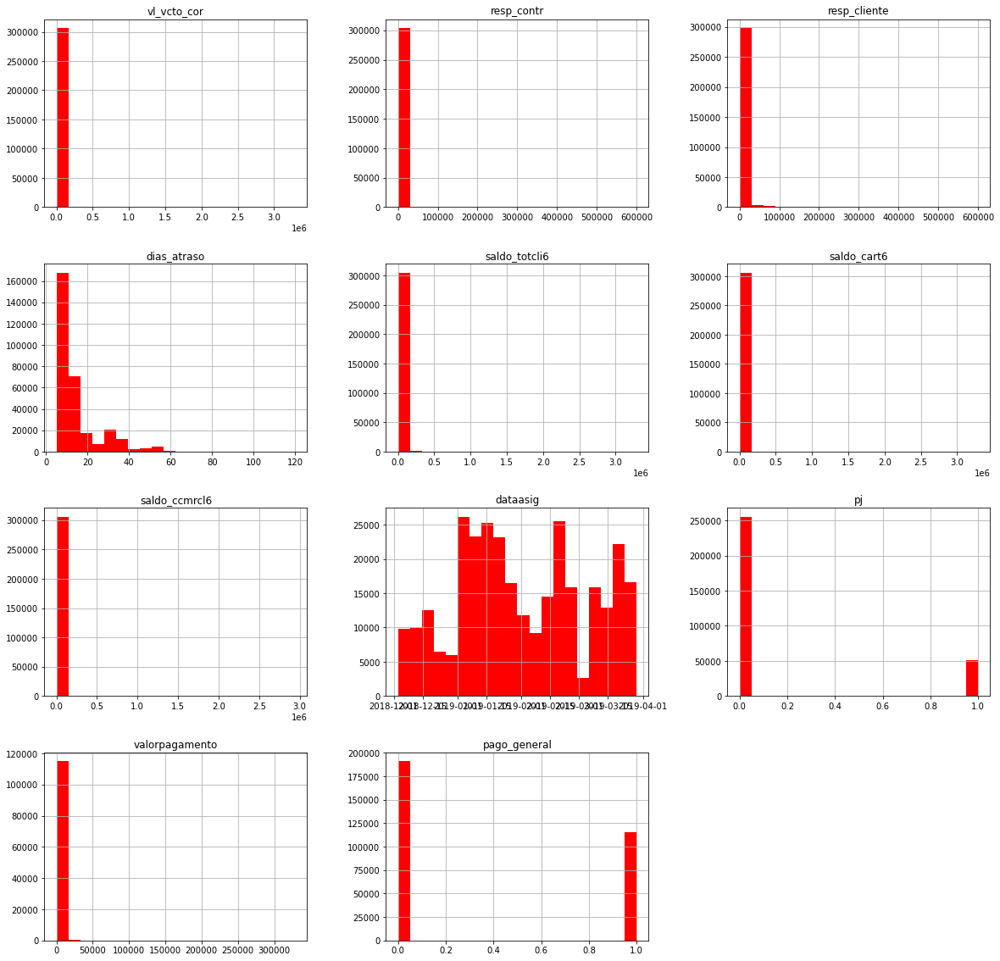

In [12]:
df.hist(bins = 20, figsize = (20,20), color = 'r')

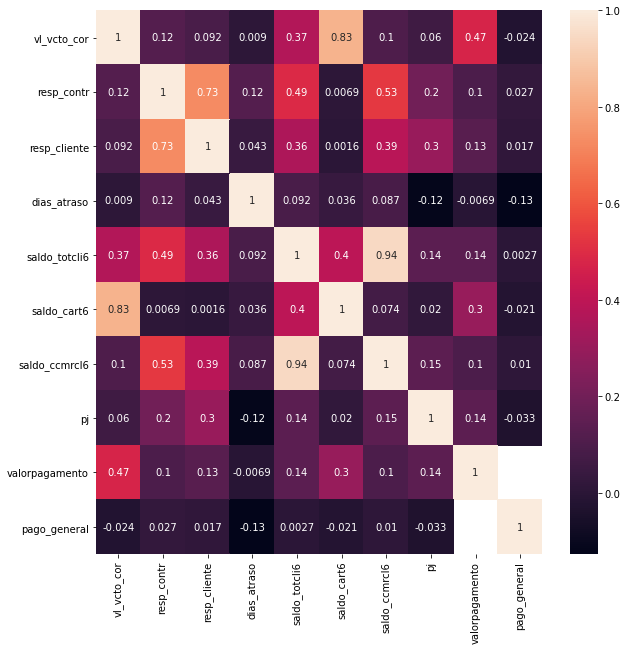

In [13]:
plt.figure(figsize = (10,10))
corr_matrix = df.corr()
sns.heatmap(corr_matrix, annot = True)
plt.show()

In [14]:
print(list(df.columns))

['location', 'banco', 'agencia', 'dir_reg', 'dt_nasc', 'uf', 'iden_tel1', 'ddd_tel1', 'iden_tel2', 'ddd_tel2', 'iden_tel3', 'ddd_tel3', 'iden_tel4', 'ddd_tel4', 'iden_tel5', 'ddd_tel5', 'iden_tel6', 'ddd_tel6', 'rating', 'dt_desde', 'nat_oper', 'carteira', 'vcto_antig', 'vl_vcto_cor', 'resp_contr', 'resp_cliente', 'ident_seg', 'produto', 'subproduto', 'familia', 'convenio', 'bs1', 'cs1', 'num_contrato', 'dias_atraso', 'saldo_totcli6', 'saldo_cart6', 'saldo_ccmrcl6', 'dataasig', 'pj', 'cpf11', 'valorpagamento', 'datapagamento', 'pago_general']


drop highly correlated variables

In [15]:
df = df.drop(['saldo_ccmrcl6', 'vl_vcto_cor', 'resp_contr'  ], axis = 1) 

In [16]:
df['location'].value_counts()

101010    254770
010102     30772
301010     20805
Name: location, dtype: int64

In [17]:
df['banco'].value_counts()

       275575
237     30772
Name: banco, dtype: int64

In [18]:
df['agencia'].value_counts()

04025    39936
03750     3659
03726      723
00265      340
00452      301
00320      294
00482      292
05750      290
00127      282
00524      273
01420      272
00523      272
03084      269
05247      268
03109      261
00358      261
00160      241
00417      240
00354      239
00272      238
00109      235
01647      235
01263      234
00321      232
03201      231
02201      229
00545      225
01382      225
00493      224
02132      220
03571      219
00606      218
00129      217
01231      216
01226      215
03711      215
01425      214
01261      212
00095      207
03567      207
00121      207
00448      201
02472      201
01011      201
01234      200
00140      196
00150      196
00665      195
00026      195
03049      195
00154      195
00046      194
07125      193
01259      192
03553      192
00406      190
00215      190
03262      190
00465      190
00405      189
00065      189
00504      189
00252      189
01442      189
03001      187
00289      185
02856     

In [19]:
df = pd.get_dummies(df, columns = ['location', 'banco', 'uf', 'rating', 'ident_seg', 'bs1', 'cs1'], drop_first = True)

In [20]:
dummy = pd.Series(df['agencia'], name='agencia')
dummy_df= dum_sign(dummy, 0.01)

In [21]:
df = pd.concat([df, dummy_df], axis=1)
df = df.drop('agencia', axis = 1) 

In [22]:
df['dir_reg'].value_counts()

        275575
4264       490
8533       392
8565       385
4669       384
4555       373
4567       373
4388       369
4385       363
4419       362
4391       361
4670       332
4679       328
4453       324
4563       321
8525       320
8553       315
4344       314
4286       314
4554       312
4581       312
4560       307
4208       303
4665       302
4034       302
4206       302
4568       301
8579       301
8547       299
4558       299
4269       298
4557       298
4285       294
4565       293
4739       293
4648       289
8555       289
8529       288
4551       285
4291       281
8543       281
4552       280
4664       279
4537       277
4202       274
4263       271
4556       271
4559       269
4672       267
4561       267
4301       266
4365       264
4207       259
4375       258
8541       256
4737       256
4667       255
4965       255
4673       253
4123       247
4569       247
4383       244
4506       244
4496       243
4498       240
8561       240
8545      

dir_reg has aprox. 90% blank. will convert column to zero for blanks 1 non-blank

In [23]:
df['dir_reg'] = df['dir_reg'].apply(lambda x: 0 if x == '' else 1)

In [24]:
df['dt_nasc'] = pd.to_datetime(df['dt_nasc'], errors='coerce')

In [25]:
df['age'] = (df['dataasig'] - df['dt_nasc']).astype('<m8[Y]')
df = df.drop('dt_nasc', axis = 1) 

Telephone variables with ddd can be dropped since we can get valid phone count
using the "V" value in the iden columns.

In [26]:
cols = [c for c in df.columns if c.lower()[:3] != 'ddd']
df = df[cols] 

In [27]:
df['iden_tel1'].value_counts()

X    272696
V     33651
Name: iden_tel1, dtype: int64

will replace valid phone value "V" with 1 so we can get a sum of valid phones

In [28]:
df.iloc[:, 1:7] = df.iloc[:, 1:7].replace({'V': 1,'X':0}).fillna(0)

In [29]:
cols = list(df.columns)

In [30]:
cols = cols[1:7]

In [31]:
df['total_phones'] = df[cols].sum(axis=1)

In [32]:
df.drop(cols, axis=1, inplace=True)

create a new tenure variable using dt_desde and dataasig

In [33]:
df['dt_desde'] = pd.to_datetime(df['dt_desde'], errors='coerce')
df['tenure'] = (df['dataasig'] - df['dt_desde']).astype('<m8[Y]')
df = df.drop('dt_desde', axis = 1) 

In [34]:
df['nat_oper'].value_counts()

3      275575
001     10993
090      7936
013      5057
057      2641
093      1989
012      1438
091       343
058       285
033        33
078        17
102        16
092        12
014         8
005         2
007         2
Name: nat_oper, dtype: int64

In [35]:
dummy = pd.Series(df['nat_oper'], name='nat_oper')
dummy_df= dum_sign(dummy, 0.01)

In [36]:
df = pd.concat([df, dummy_df], axis=1)
df = df.drop('nat_oper', axis = 1) 

In [37]:
df['carteira'].value_counts()

       275575
455      7936
722      4426
351      2838
379      2758
842      2640
385      2312
DCC      1989
530      1906
227      1431
331       544
729       373
375       343
773       309
469       308
809       285
EXL        95
GFC        45
266        33
771        32
393        30
532        17
288        15
136        13
340        12
CAF        11
712         8
621         6
144         6
944         5
CFF         5
448         5
117         4
451         4
226         4
349         4
404         2
700         2
551         2
406         2
263         2
591         2
039         1
044         1
304         1
688         1
510         1
124         1
841         1
321         1
Name: carteira, dtype: int64

In [38]:
dummy = pd.Series(df['carteira'], name='carteira')
dummy_df= dum_sign(dummy, 0.005)

In [39]:
df = pd.concat([df, dummy_df], axis=1)
df = df.drop(['carteira', 'vcto_antig', 'familia'], axis = 1) #vcto_antig same as dias_atraso
#familia highly corr with produto

In [40]:
df['produto'].value_counts()

000    277980
004     15608
011      7936
002      2926
005      1531
019       340
012        18
006         8
Name: produto, dtype: int64

In [41]:
df['prod_000'] = df['produto'].apply(lambda x: 0 if x != '000' else 1)
df['prod_004'] = df['produto'].apply(lambda x: 0 if x != '004' else 1)
df['prod_011'] = df['produto'].apply(lambda x: 0 if x != '011' else 1)
df = df.drop('produto', axis = 1)

In [42]:
df['subprod_000'] = df['subproduto'].apply(lambda x: 0 if x != '000' else 1)
df['subprod_006'] = df['subproduto'].apply(lambda x: 0 if x != '006' else 1)
df['subprod_061'] = df['subproduto'].apply(lambda x: 0 if x != '061' else 1)
df = df.drop('subproduto', axis = 1)

In [43]:
df['convenio'].value_counts()

000000000    295104
000004930      2015
000007537      1902
000009151      1136
000009152       678
000004762       536
000011176       455
000005780       341
000007538       308
000005377       291
000005755       215
000009160       182
000004637       178
000007291       165
000004931       163
000005784       155
000004932       119
000016324        97
000009159        94
000005747        88
000010910        88
000005744        81
000009157        78
000010615        77
000005311        72
000005773        64
000010894        57
000010613        55
000005799        48
000004752        48
000010889        48
000010458        46
000005384        45
000005779        44
000010614        42
000004933        42
000004759        41
000010914        40
000005765        40
000010915        40
000011161        38
000010905        38
000010904        38
000010909        38
000011100        31
000000008        31
000011160        31
000009467        30
000005749        30
000011162        29


In [44]:
dummy = pd.Series(df['convenio'], name='convenio')
dummy_df= dum_sign(dummy, 0.005)

In [45]:
df = pd.concat([df, dummy_df], axis=1)
df = df.drop('convenio', axis = 1)

get unique count of contracts for each cpf

In [46]:

nval_df = df.groupby('cpf11').num_contrato.agg(nvals='nunique')

merge unique contract count df with original df

In [47]:
df = pd.merge(df, nval_df, left_on ='cpf11', right_on = 'cpf11', how='left')

drop the others column from all dummies to avoid dummy trap

In [48]:
cols = [col for col in df.columns if '_others' not in col]
df = df[cols] 

In [49]:
del cols
del nval_df
del dummy
del dummy_df

In [50]:
df['dir_reg'].head()

0    1
1    0
2    0
3    0
4    0
Name: dir_reg, dtype: int64

In [51]:
df['dir_reg'].value_counts()

0    275575
1     30772
Name: dir_reg, dtype: int64

In [52]:
df.dtypes

dir_reg                        int64
resp_cliente                   int32
num_contrato                  object
dias_atraso                    int16
saldo_totcli6                float32
saldo_cart6                  float32
dataasig              datetime64[ns]
pj                           float32
cpf11                         object
valorpagamento               float64
datapagamento                 object
pago_general                   int64
location_101010                uint8
location_301010                uint8
banco_237                      uint8
uf_AC                          uint8
uf_AL                          uint8
uf_AM                          uint8
uf_AP                          uint8
uf_BA                          uint8
uf_CE                          uint8
uf_DF                          uint8
uf_ES                          uint8
uf_GO                          uint8
uf_MA                          uint8
uf_MG                          uint8
uf_MS                          uint8
u

get a subset of variables to review in correlation matrix

In [53]:
corr_df = df.iloc[:, np.r_[0:15, 42:103]]

<AxesSubplot:>

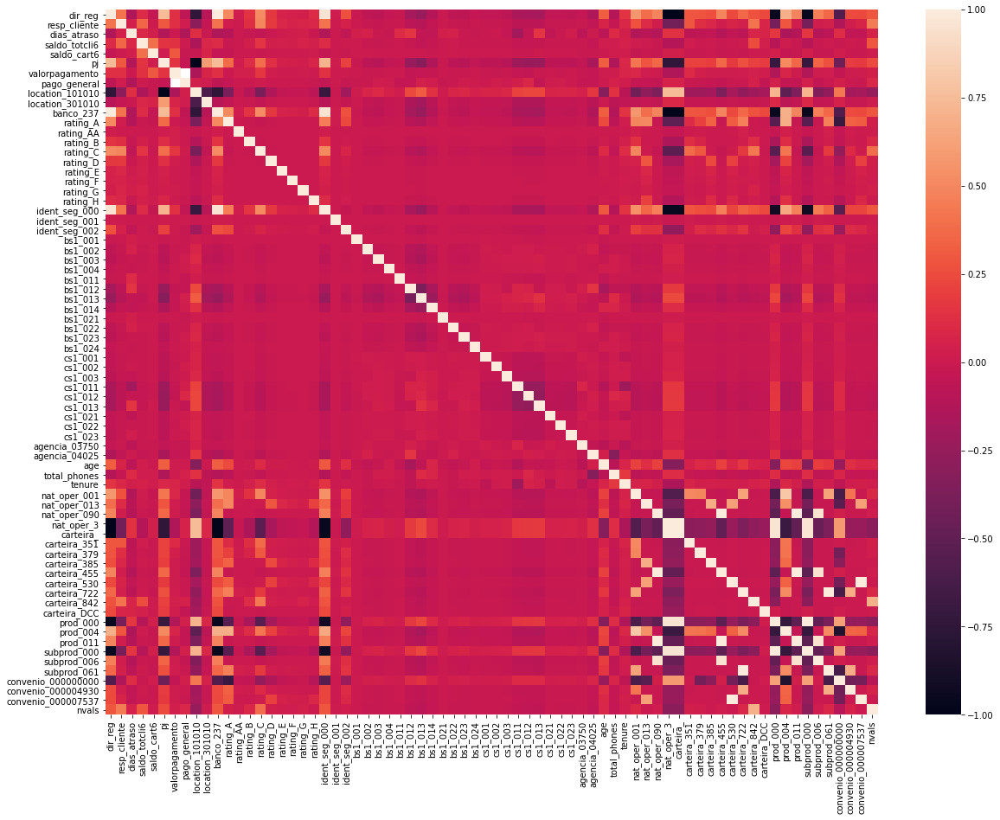

In [54]:
corr_matrix = corr_df.corr()
plt.subplots(figsize=(20,15))
sns.heatmap(corr_matrix)

will drop one of the pairs from too highly correlated variables.

In [55]:
df = df.drop(['dir_reg', 'ident_seg_000', 'nat_oper_090', 'subprod_006', 'subprod_000', 'subprod_061'] , axis = 1)

# Get Cumulative Info for key variables then dedupe by CPF

In [56]:
def trans_max(*args, key):
    """ This function transforms the column by performing a groupby on the key
    column and summing the values."""
    
    for arg in args:
        df[arg] = df[arg].groupby(df[key]).transform('max')
    return df[arg]

In [57]:
trans_max('pj',
          'pago_general', 'location_101010', 'location_301010', 'banco_237',
          'uf_AC', 'uf_AL', 'uf_AM', 'uf_AP', 'uf_BA', 'uf_CE', 'uf_DF',
          'uf_ES', 'uf_GO', 'uf_MA', 'uf_MG', 'uf_MS', 'uf_MT', 'uf_PA',
          'uf_PB', 'uf_PE', 'uf_PI', 'uf_PR', 'uf_RJ', 'uf_RN', 'uf_RO',
          'uf_RR', 'uf_RS', 'uf_SC', 'uf_SE', 'uf_SP', 'uf_TO', 'rating_A',
          'rating_AA', 'rating_B', 'rating_C', 'rating_D', 'rating_E', 'rating_F',
          'rating_G', 'rating_H', 'ident_seg_002',
          'bs1_001', 'bs1_002', 'bs1_003', 'bs1_004', 'bs1_011', 'bs1_012',
          'bs1_013', 'bs1_014', 'bs1_021', 'bs1_022', 'bs1_023', 'bs1_024',
          'cs1_001', 'cs1_002', 'cs1_003', 'cs1_011', 'cs1_012', 'cs1_013',
          'cs1_021', 'cs1_022', 'cs1_023', 'agencia_03750', 'agencia_04025',
          'nat_oper_001', 'nat_oper_013', 'nat_oper_3', 'carteira_',
          'carteira_351', 'carteira_379', 'carteira_385', 'carteira_455',
          'carteira_530', 'carteira_722', 'carteira_842', 'carteira_DCC',
          'prod_000', 'prod_004', 'prod_011', 'convenio_000000000', 'convenio_000004930',
          'convenio_000007537', 'nvals' , key = 'cpf11')

0          1
1          1
2          1
3          1
4          1
5          2
6          2
7          1
8          1
9          2
10         2
11         1
12         1
13         1
14         1
15         1
16         1
17         1
18         1
19         1
20         1
21         1
22         1
23         1
24         1
25         1
26         1
27         1
28         1
29         1
30         2
31         2
32         1
33         1
34         1
35         1
36         1
37         1
38         1
39         1
40         1
41         1
42         6
43         6
44         6
45         6
46         6
47         6
48         1
49         1
50         1
51         1
52         1
53         1
54         1
55         1
56         1
57         1
58         1
59         2
60         2
61         1
62         1
63         1
64         1
65         1
66         1
67         1
68         1
69         1
70         1
71         1
72         1
73         1
74         1
75         1
76         1

In [58]:
def trans_sum(*args, key):
    """ This function transforms the column by performing a groupby on the key
    column and summing the values."""
    
    for arg in args:
        df[arg] = df[arg].groupby(df[key]).transform('sum')
    return df[arg]

In [59]:
trans_sum('resp_cliente','total_phones',
          'saldo_totcli6', 'saldo_cart6','valorpagamento', key='cpf11')

0           2369.94
1              0.00
2              0.00
3            368.74
4              0.00
5              0.00
6              0.00
7              0.00
8              0.00
9           1979.32
10          1979.32
11             0.00
12             0.00
13             0.00
14             0.00
15             0.00
16             0.00
17            53.56
18         26883.38
19             0.00
20          1383.60
21            54.97
22             0.00
23             0.00
24             0.00
25          1050.06
26             0.00
27             0.00
28          3473.12
29          1621.90
30             0.00
31             0.00
32             0.00
33             0.00
34            86.60
35             0.00
36             0.00
37             0.00
38          1236.23
39             0.00
40          1040.89
41           156.23
42         25352.88
43         25352.88
44         25352.88
45         25352.88
46         25352.88
47         25352.88
48             0.00
49             0.00


In [60]:
def trans_mean(*args, key):
    """ This function transform the column by performing a groupby on the key
    column and summing the values."""
   
    for arg in args:
        df[arg] = df[arg].groupby(df[key]).transform('mean')
    return df[arg]

In [61]:
trans_mean('age', 'tenure', 'dias_atraso', key='cpf11')

0           5.000000
1          15.000000
2          35.000000
3          15.000000
4           9.000000
5           9.000000
6           9.000000
7           5.000000
8          51.000000
9           6.500000
10          6.500000
11          5.000000
12         15.000000
13         15.000000
14         49.000000
15          9.000000
16         10.000000
17          5.000000
18         24.000000
19          9.000000
20          9.000000
21         31.000000
22          5.000000
23          5.000000
24         15.000000
25          6.000000
26         15.000000
27          9.000000
28         33.000000
29          9.000000
30         17.500000
31         17.500000
32         10.000000
33         15.000000
34         11.000000
35         56.000000
36          6.000000
37          7.000000
38         15.000000
39          5.000000
40         16.000000
41          9.000000
42         13.000000
43         13.000000
44         13.000000
45         13.000000
46         13.000000
47         13

In [62]:
df = df.drop_duplicates(subset=['cpf11'])

In [63]:
print(list(df.columns))

['resp_cliente', 'num_contrato', 'dias_atraso', 'saldo_totcli6', 'saldo_cart6', 'dataasig', 'pj', 'cpf11', 'valorpagamento', 'datapagamento', 'pago_general', 'location_101010', 'location_301010', 'banco_237', 'uf_AC', 'uf_AL', 'uf_AM', 'uf_AP', 'uf_BA', 'uf_CE', 'uf_DF', 'uf_ES', 'uf_GO', 'uf_MA', 'uf_MG', 'uf_MS', 'uf_MT', 'uf_PA', 'uf_PB', 'uf_PE', 'uf_PI', 'uf_PR', 'uf_RJ', 'uf_RN', 'uf_RO', 'uf_RR', 'uf_RS', 'uf_SC', 'uf_SE', 'uf_SP', 'uf_TO', 'rating_A', 'rating_AA', 'rating_B', 'rating_C', 'rating_D', 'rating_E', 'rating_F', 'rating_G', 'rating_H', 'ident_seg_001', 'ident_seg_002', 'bs1_001', 'bs1_002', 'bs1_003', 'bs1_004', 'bs1_011', 'bs1_012', 'bs1_013', 'bs1_014', 'bs1_021', 'bs1_022', 'bs1_023', 'bs1_024', 'cs1_001', 'cs1_002', 'cs1_003', 'cs1_011', 'cs1_012', 'cs1_013', 'cs1_021', 'cs1_022', 'cs1_023', 'agencia_03750', 'agencia_04025', 'age', 'total_phones', 'tenure', 'nat_oper_001', 'nat_oper_013', 'nat_oper_3', 'carteira_', 'carteira_351', 'carteira_379', 'carteira_385', 

In [64]:
df = df.drop(['num_contrato', 'dataasig', 'cpf11', 'datapagamento'], axis = 1) 

In [65]:
# split the dataframe into target and features

df_target = df['pago_general']
df_final = df.drop(columns =['pago_general', 'valorpagamento'])

In [66]:
df_final.shape

(264534, 91)

In [67]:
df_target.shape

(264534,)

In [68]:
#spliting the data in to test and train sets
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df_final, df_target, test_size = 0.2)



In [69]:
X_train.reset_index(drop=True, inplace=True)

In [70]:
X_train.shape

(211627, 91)

In [71]:
y_train.shape

(211627,)

In [72]:
X_test.shape

(52907, 91)

In [73]:
X_test.shape

(52907, 91)

In [74]:
!pip install xgboost

In [75]:
X_train.head()

,resp_cliente,dias_atraso,saldo_totcli6,saldo_cart6,pj,location_101010,location_301010,banco_237,uf_AC,uf_AL,uf_AM,uf_AP,uf_BA,uf_CE,uf_DF,uf_ES,uf_GO,uf_MA,uf_MG,uf_MS,uf_MT,uf_PA,uf_PB,uf_PE,uf_PI,uf_PR,uf_RJ,uf_RN,uf_RO,uf_RR,uf_RS,uf_SC,uf_SE,uf_SP,uf_TO,rating_A,rating_AA,rating_B,rating_C,rating_D,rating_E,rating_F,rating_G,rating_H,ident_seg_001,ident_seg_002,bs1_001,bs1_002,bs1_003,bs1_004,bs1_011,bs1_012,bs1_013,bs1_014,bs1_021,bs1_022,bs1_023,bs1_024,cs1_001,cs1_002,cs1_003,cs1_011,cs1_012,cs1_013,cs1_021,cs1_022,cs1_023,agencia_03750,agencia_04025,age,total_phones,tenure,nat_oper_001,nat_oper_013,nat_oper_3,carteira_,carteira_351,carteira_379,carteira_385,carteira_455,carteira_530,carteira_722,carteira_842,carteira_DCC,prod_000,prod_004,prod_011,convenio_000000000,convenio_000004930,convenio_000007537,nvals
0,21410,14.333333,18718.849609,0.000000,1.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11.0,6,1.0,1,0,0,0,0,1,0,1,0,1,0,0,0,1,1,1,1,0,3
1,0,19.000000,908.340027,908.340027,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,49.0,2,5.0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1
2,0,6.000000,516.929993,516.929993,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,41.0,0,13.0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1
3,0,50.000000,945.299988,945.299988,0.0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,36.0,2,3.0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1
4,0,5.000000,448.250000,448.250000,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,32.0,2,0.0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1


In [76]:
from xgboost import XGBClassifier

model = XGBClassifier(use_label_encoder = False, learning_rate=0.01, n_estimators=100,
                      subsample = 0.8, colsample_bytree = 0.8, max_depth = 3, gamma=1)

model.fit(X_train, y_train)

[18:13:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=1, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.01, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.8,
              tree_method='exact', use_label_encoder=False,
              validate_parameters=1, verbosity=None)

In [77]:
# make predictions on test data

predict = model.predict(X_test)

In [78]:
predict

array([0, 1, 0, ..., 0, 0, 0])

# Assess trained model performance on training dataset

In [79]:
predict_train = model.predict(X_train)

from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc, roc_auc_score

cm = confusion_matrix(y_train, predict_train)


In [80]:
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

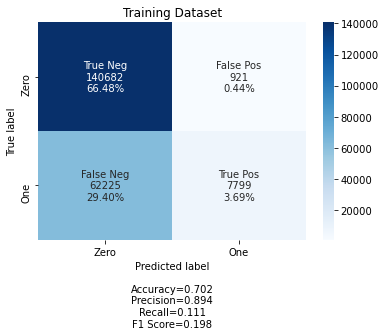

In [81]:
labels = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cm, 
                      group_names=labels,
                      categories=categories,
                      title='Training Dataset')

In [82]:
auc = roc_auc_score(y_train, predict_train)
auc

0.5524360000667845

# Assess trained model performance on testing dataset

In [83]:
cm = confusion_matrix(y_test, predict)

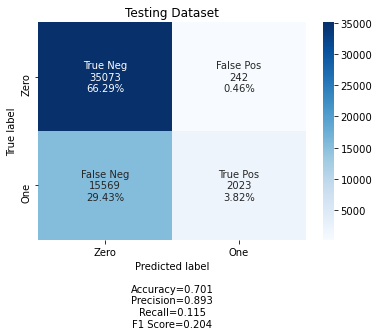

In [84]:
labels = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cm, 
                      group_names=labels,
                      categories=categories,
                      title='Testing Dataset')

Generate ROC Curves and AUC

In [85]:
# generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]
# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, predict)
tr_fpr, tr_tpr, _ = roc_curve(y_train, predict_train)

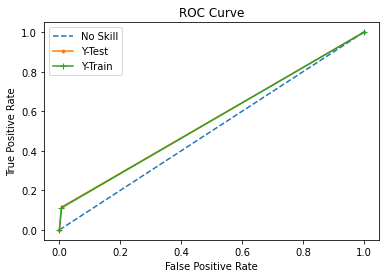

In [86]:
# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='Y-Test')
plt.plot(tr_fpr, tr_tpr, marker='+', label='Y-Train' )
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# title
plt.title('ROC Curve')
# show the plot
plt.show()

In [87]:
auc = roc_auc_score(y_test, predict)
auc

0.5540714201369769

In [88]:
eval_set = [(X_train, y_train), (X_test, y_test)]
eval_metric = ["auc","error"]
epochs_hist = %time model.fit(X_train, y_train, eval_metric=eval_metric, eval_set=eval_set, verbose=True)

[0]	validation_0-auc:0.62314	validation_0-error:0.29972	validation_1-auc:0.62502	validation_1-error:0.30098
[1]	validation_0-auc:0.62424	validation_0-error:0.29972	validation_1-auc:0.62616	validation_1-error:0.30098
[2]	validation_0-auc:0.62432	validation_0-error:0.29972	validation_1-auc:0.62627	validation_1-error:0.30098
[3]	validation_0-auc:0.62432	validation_0-error:0.29953	validation_1-auc:0.62627	validation_1-error:0.30043
[4]	validation_0-auc:0.62460	validation_0-error:0.29953	validation_1-auc:0.62645	validation_1-error:0.30043
[5]	validation_0-auc:0.63965	validation_0-error:0.29972	validation_1-auc:0.64250	validation_1-error:0.30098
[6]	validation_0-auc:0.63970	validation_0-error:0.29972	validation_1-auc:0.64251	validation_1-error:0.30098
[7]	validation_0-auc:0.63970	validation_0-error:0.29972	validation_1-auc:0.64251	validation_1-error:0.30098
[8]	validation_0-auc:0.63965	validation_0-error:0.29972	validation_1-auc:0.64246	validation_1-error:0.30098
[9]	validation_0-auc:0.63960

In [89]:
results = model.evals_result()
epochs = len(results['validation_0']['error'])
x_axis = range(0, epochs)

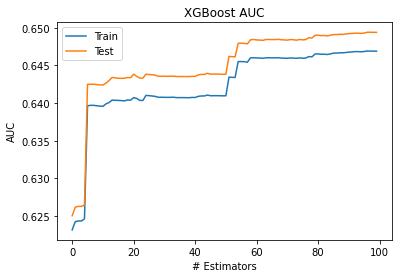

In [90]:
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['auc'], label='Train')
ax.plot(x_axis, results['validation_1']['auc'], label='Test')
ax.legend()
plt.ylabel('AUC')
plt.title('XGBoost AUC')
plt.xlabel('# Estimators')
plt.show()

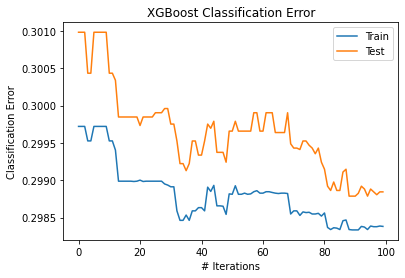

In [91]:
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['error'], label='Train')
ax.plot(x_axis, results['validation_1']['error'], label='Test')
ax.legend()
plt.ylabel('Classification Error')
plt.title('XGBoost Classification Error')
plt.xlabel('# Iterations')
plt.show()

# Fine tuning hyperparameters (first time)

In [92]:
from xgboost import XGBClassifier
#reduce estimators to 50 and increase max depth to 5
model = XGBClassifier(use_label_encoder = False, learning_rate=0.01, n_estimators=50,
                      subsample = 0.8, colsample_bytree = 0.8, max_depth = 5, gamma=1)

model.fit(X_train, y_train)

[18:14:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=1, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.01, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=50, n_jobs=8, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.8,
              tree_method='exact', use_label_encoder=False,
              validate_parameters=1, verbosity=None)

In [93]:
# make predictions on test data

predict = model.predict(X_test)

In [94]:
predict

array([0, 1, 0, ..., 0, 0, 0])

# Assess trained model performance on training dataset

In [95]:
predict_train = model.predict(X_train)

cm = confusion_matrix(y_train, predict_train)


In [96]:
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

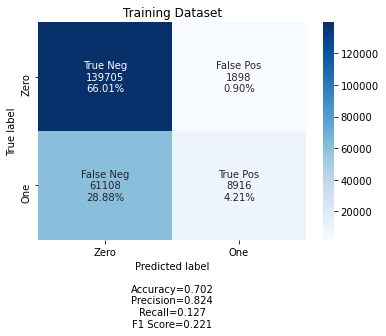

In [97]:
labels = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cm, 
                      group_names=labels,
                      categories=categories,
                      title='Training Dataset')

In [98]:
auc = roc_auc_score(y_train, predict_train)
auc

0.5569620512543367

# Assess trained model performance on testing dataset

In [99]:
cm = confusion_matrix(y_test, predict)

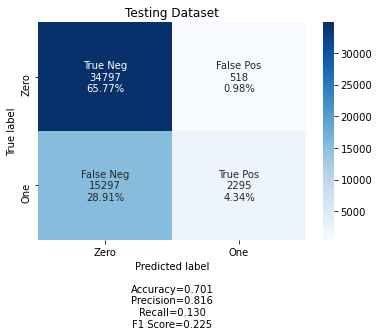

In [100]:
labels = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cm, 
                      group_names=labels,
                      categories=categories,
                      title='Testing Dataset')

Generate ROC Curves and AUC

In [101]:
# generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]
# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, predict)
tr_fpr, tr_tpr, _ = roc_curve(y_train, predict_train)

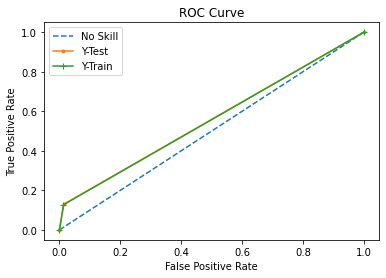

In [102]:
# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='Y-Test')
plt.plot(tr_fpr, tr_tpr, marker='+', label='Y-Train' )
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# title
plt.title('ROC Curve')
# show the plot
plt.show()

In [103]:
auc = roc_auc_score(y_test, predict)
auc

0.5578945189069182

In [104]:
eval_set = [(X_train, y_train), (X_test, y_test)]
eval_metric = ["auc","error"]
epochs_hist = %time model.fit(X_train, y_train, eval_metric=eval_metric, eval_set=eval_set, verbose=True)

[0]	validation_0-auc:0.64283	validation_0-error:0.29905	validation_1-auc:0.64498	validation_1-error:0.29989
[1]	validation_0-auc:0.65330	validation_0-error:0.29889	validation_1-auc:0.65584	validation_1-error:0.29983
[2]	validation_0-auc:0.65339	validation_0-error:0.29872	validation_1-auc:0.65603	validation_1-error:0.29968
[3]	validation_0-auc:0.65346	validation_0-error:0.29874	validation_1-auc:0.65621	validation_1-error:0.29968
[4]	validation_0-auc:0.65480	validation_0-error:0.29868	validation_1-auc:0.65720	validation_1-error:0.29968
[5]	validation_0-auc:0.65743	validation_0-error:0.29868	validation_1-auc:0.65948	validation_1-error:0.29973
[6]	validation_0-auc:0.65734	validation_0-error:0.29864	validation_1-auc:0.65949	validation_1-error:0.29981
[7]	validation_0-auc:0.65738	validation_0-error:0.29866	validation_1-auc:0.65953	validation_1-error:0.29981
[8]	validation_0-auc:0.65738	validation_0-error:0.29868	validation_1-auc:0.65951	validation_1-error:0.29975
[9]	validation_0-auc:0.65734

In [105]:
results = model.evals_result()
epochs = len(results['validation_0']['error'])
x_axis = range(0, epochs)

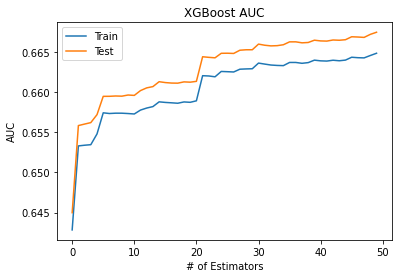

In [106]:
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['auc'], label='Train')
ax.plot(x_axis, results['validation_1']['auc'], label='Test')
ax.legend()
plt.ylabel('AUC')
plt.title('XGBoost AUC')
plt.xlabel('# of Estimators')
plt.show()

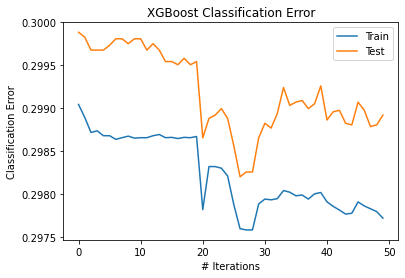

In [107]:
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['error'], label='Train')
ax.plot(x_axis, results['validation_1']['error'], label='Test')
ax.legend()
plt.ylabel('Classification Error')
plt.title('XGBoost Classification Error')
plt.xlabel('# Iterations')
plt.show()

# Fine tuning hyperparameters (additional changes multiple times)

In [108]:
from xgboost import XGBClassifier

model = XGBClassifier(use_label_encoder = False, learning_rate=0.01, n_estimators=20,
                      subsample = 1, colsample_bytree = 0.8, max_depth = 20, gamma=1)

model.fit(X_train, y_train)

[18:14:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=1, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.01, max_delta_step=0, max_depth=20,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=20, n_jobs=8, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', use_label_encoder=False,
              validate_parameters=1, verbosity=None)

In [109]:
# make predictions on test data

predict = model.predict(X_test)

In [110]:
predict

array([0, 1, 0, ..., 0, 0, 0])

# Assess trained model performance on training dataset

In [111]:
predict_train = model.predict(X_train)

cm = confusion_matrix(y_train, predict_train)


In [112]:
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

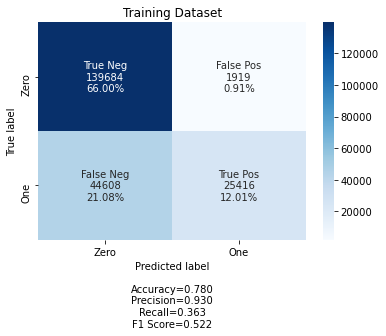

In [113]:
labels = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cm, 
                      group_names=labels,
                      categories=categories,
                      title='Training Dataset')

In [114]:
auc = roc_auc_score(y_train, predict_train)
auc

0.6747046488263155

# Assess trained model performance on testing dataset

In [115]:
cm = confusion_matrix(y_test, predict)

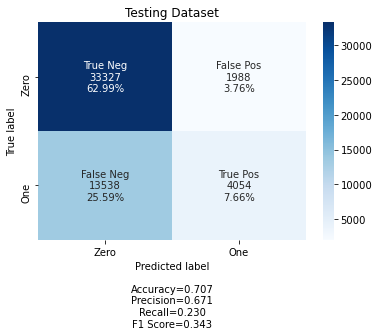

In [116]:
labels = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cm, 
                      group_names=labels,
                      categories=categories,
                      title='Testing Dataset')

Generate ROC Curves and AUC

In [117]:
# generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]
# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, predict)
tr_fpr, tr_tpr, _ = roc_curve(y_train, predict_train)

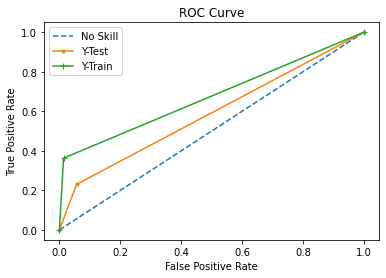

In [118]:
# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='Y-Test')
plt.plot(tr_fpr, tr_tpr, marker='+', label='Y-Train' )
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# title
plt.title('ROC Curve')
# show the plot
plt.show()

In [119]:
auc = roc_auc_score(y_test, predict)
auc

0.5870761486773654

In [120]:
eval_set = [(X_train, y_train), (X_test, y_test)]
eval_metric = ["auc","error"]
epochs_hist = %time model.fit(X_train, y_train, eval_metric=eval_metric, eval_set=eval_set, verbose=True)

[0]	validation_0-auc:0.77073	validation_0-error:0.24763	validation_1-auc:0.67390	validation_1-error:0.30922
[1]	validation_0-auc:0.79720	validation_0-error:0.23558	validation_1-auc:0.68308	validation_1-error:0.30385
[2]	validation_0-auc:0.82119	validation_0-error:0.22611	validation_1-auc:0.69054	validation_1-error:0.30104
[3]	validation_0-auc:0.82455	validation_0-error:0.22650	validation_1-auc:0.69463	validation_1-error:0.29801
[4]	validation_0-auc:0.82888	validation_0-error:0.22523	validation_1-auc:0.69630	validation_1-error:0.29711
[5]	validation_0-auc:0.84129	validation_0-error:0.22409	validation_1-auc:0.69690	validation_1-error:0.29692
[6]	validation_0-auc:0.84311	validation_0-error:0.22285	validation_1-auc:0.69879	validation_1-error:0.29520
[7]	validation_0-auc:0.84703	validation_0-error:0.22079	validation_1-auc:0.69839	validation_1-error:0.29503
[8]	validation_0-auc:0.84695	validation_0-error:0.22096	validation_1-auc:0.69813	validation_1-error:0.29518
[9]	validation_0-auc:0.84652

In [121]:
results = model.evals_result()
epochs = len(results['validation_0']['error'])
x_axis = range(0, epochs)

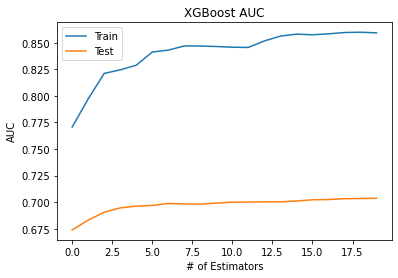

In [122]:
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['auc'], label='Train')
ax.plot(x_axis, results['validation_1']['auc'], label='Test')
ax.legend()
plt.ylabel('AUC')
plt.title('XGBoost AUC')
plt.xlabel('# of Estimators')
plt.show()

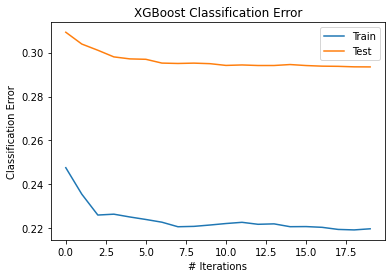

In [123]:
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['error'], label='Train')
ax.plot(x_axis, results['validation_1']['error'], label='Test')
ax.legend()
plt.ylabel('Classification Error')
plt.title('XGBoost Classification Error')
plt.xlabel('# Iterations')
plt.show()